In [1]:
# imports 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from datetime import datetime as dt
#from haversine import haversine
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
# import make_subplots from plotly
from plotly.subplots import make_subplots
#from keplergl import KeplerGl
#import swifter
from tqdm.auto import tqdm
# import stats from scipy
from scipy import stats
#import geopandas as gpd
# see all columns
pd.set_option('display.max_columns', None)
# set seaborn style
sns.set_style('whitegrid')
# set context to notebook
sns.set_context('notebook')

# Set the default template
pio.templates.default = "plotly_white"

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [2]:
trips = pd.read_csv('../data/processed/car_trips.csv')

In [3]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'LatitudeStart', 'LongitudeStart',
       'LatitudeEnd', 'LongitudeEnd', 'DistanceKm', 'Month', 'StartHour',
       'Weekday', 'TripDurationMin', 'SpeedKmHr', 'PubTDurationMin',
       'PubTDistanceKm', 'PubTWalkingTimeMin', 'PubTTransitTimeMin',
       'PubTChanges', 'PickupStationProximity', 'DropoffStationProximity',
       'UserCategory', 'StartZoneId', 'StartZoneName', 'StartZoneDescri',
       'EndZoneId', 'EndZoneName', 'EndZoneDescri', 'StartZoneCounts',
       'EndZoneCounts', 'TripDurationDiff', 'Mode', 'TripDurationDifference'],
      dtype='object')

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


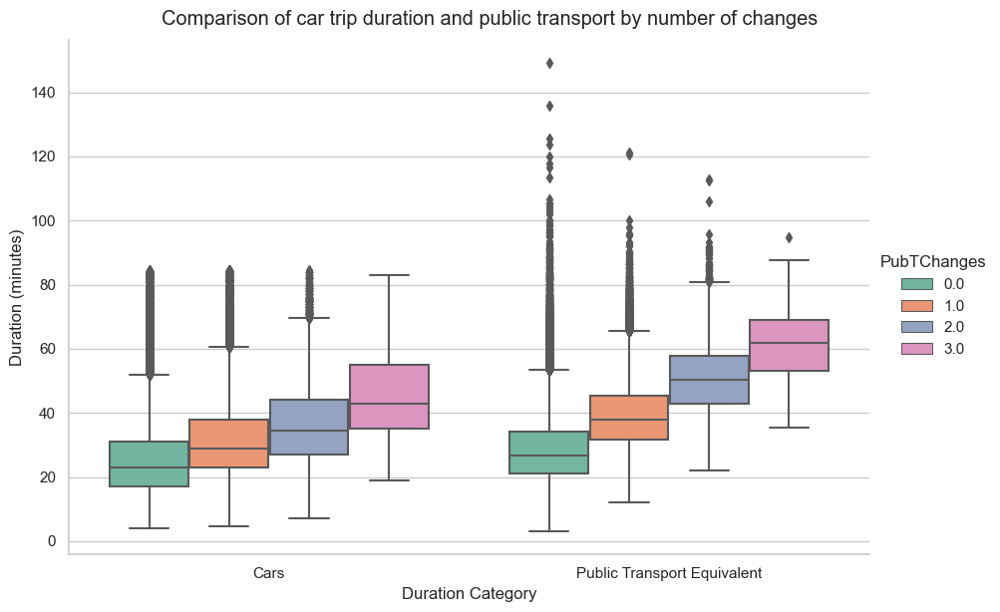

In [4]:
# Convert 'Changes' to categorical type
trips['PubTChanges'] = trips['PubTChanges'].astype('category')

# Preparing the data: Since sns.catplot does not support direct comparison of two columns in the way px.box does,
# we need to melt the DataFrame
trips_melted = pd.melt(trips, id_vars=['PubTChanges'], value_vars=['TripDurationMin', 'PubTDurationMin'],
                    var_name='DurationType', value_name='Duration')

# Creating the catplot with boxplots
g = sns.catplot(x='DurationType', y='Duration', hue='PubTChanges', data=trips_melted, kind='box',
                height=6, aspect=1.5, palette='Set2')

g.fig.suptitle('Comparison of car trip duration and public transport by number of changes', y=1.02)
g.set_axis_labels('Duration Category', 'Duration (minutes)')
# set xticks
g.set_xticklabels(['Cars', 'Public Transport Equivalent'])
g.set_titles("{col_name}")

plt.show()

In [5]:
trips_melted.head()

,PubTChanges,DurationType,Duration
0,0.0,TripDurationMin,9.166667
1,0.0,TripDurationMin,10.833333
2,0.0,TripDurationMin,21.716667
3,0.0,TripDurationMin,6.850000
4,1.0,TripDurationMin,48.983333


In [50]:
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy import stats

# Assuming 'trips_melted' DataFrame and 'Changes' and 'DurationType' columns are defined

# Define colors for each duration type
colors = ['#1f77b4', 'orange']

# Create subplots with 1 row and 3 columns
fig = make_subplots(rows=1, cols=4, horizontal_spacing=0.04, subplot_titles=['Changes: 0', 'Changes: 1', 'Changes: 2'])
# Loop through each category and create distplots
for i, category in enumerate(sorted(trips_melted['PubTChanges'].unique())):
    # Filter data for the category and duration type
    category_data = trips_melted[trips_melted['PubTChanges'] == category]
    bike_duration_data = category_data[category_data['DurationType'] == "TripDurationMin"]['Duration']
    public_transport_duration_data = category_data[category_data['DurationType'] == "PubTDurationMin"]['Duration']
    # Define the desired number of bins
    desired_nbins = 30

    # Calculate the range of your data (max - min)
    start = min(bike_duration_data.min(), public_transport_duration_data.min())
    end = max(bike_duration_data.max(), public_transport_duration_data.max())
    data_range = end - start

    # Calculate the bin size based on the desired number of bins
    bin_size = data_range / desired_nbins
    # Create distplots for the current category
    hist_data = [bike_duration_data, public_transport_duration_data]
    group_labels = [f'Car Duration', f'Public Transport Duration']
    distplot_fig = ff.create_distplot(hist_data, group_labels,  show_hist=True, show_rug=False, colors=colors, bin_size=bin_size)
    
    # Extract the traces from the distplot and add them to the subplots
    for j, trace in enumerate(distplot_fig['data']):
        show_legend = (i == 0) and (j < 2)  # Show legend only for the first subplot and first two traces
        fig.add_trace(trace, row=1, col=i+1, )
        fig.data[-1].update(showlegend=show_legend)
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_bike = stats.shapiro(bike_duration_data.sample(min(5000, len(bike_duration_data))))
    shapiro_public_transport = stats.shapiro(public_transport_duration_data.sample(min(5000, len(public_transport_duration_data))))

    
    # Calculate histograms using numpy
    hist_bike, _ = np.histogram(bike_duration_data, bins=desired_nbins, density = True)
    hist_public_transport, _ = np.histogram(public_transport_duration_data, bins=desired_nbins, density = True)
    
    # Find the maximum y-value (count) for each histogram and store it
    max_y_bike = np.max(hist_bike)
    max_y_public_transport = np.max(hist_public_transport)
    
    # Store the larger of the two maximum y-values
    max_y_value = max(max_y_bike, max_y_public_transport)

    fig.add_annotation(
        text=f"Car Normality p-value: {shapiro_bike.pvalue:.3f}",
        xref=f"x{i+1}", yref="paper",
        x=end,
        y=0.98,
        showarrow=False,
        font=dict(size=12, color='#1f77b4'),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )
    fig.add_annotation(
        text=f"Public T Normality p-value: {shapiro_public_transport.pvalue:.3f}",
        xref=f"x{i+1}", yref='paper',
        x=end,
        y=0.95,
        showarrow=False,
        font=dict(size=12, color="orange"),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    #title= dict(font = dict(size=22), text='Distribution of Duration by Change and Duration Type', x = 0.5, xanchor = 'center', y = 0.98),
    height=700, width=1200,
    legend=dict(orientation="h", yanchor="top", y=1.15, x=0.5, traceorder='normal', xanchor='center',font = dict(size=16)),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
)
fig.update_xaxes(title_text='Duration', row=1, col=2, title_font=dict(size=18), tickfont=dict(size=16))
fig.update_xaxes(row=1, col=1,  tickfont=dict(size=16))
fig.update_xaxes(row=1, col=3,  tickfont=dict(size=16))
fig.update_xaxes(row=1, col=4,  tickfont=dict(size=16))
fig.update_yaxes(title_text='Density', row=1, col=1, title_font=dict(size=18), tickfont=dict(size=16))
fig.update_yaxes(row=1, col=2,  tickfont=dict(size=16))
fig.update_yaxes(row=1, col=3,  tickfont=dict(size=16))
fig.update_yaxes(row=1, col=4,  tickfont=dict(size=16))
# Show the figure
fig.show()
# save the figure as png in high quality in current directory
#fig.write_image("bike_duration_kde.png", scale=3)


In [7]:
# Reshape the data to long format
trips_melted = pd.melt(trips, id_vars=['PubTChanges', 'UserId'], value_vars=['TripDurationMin', 'PubTDurationMin'], var_name='DurationType', value_name='Duration')

# Perform pairwise Wilcoxon tests
pairwise_results = pg.pairwise_tests(data=trips_melted, dv='Duration', between = 'DurationType',  within='PubTChanges', subject='UserId', parametric=False, padjust='bonf').round(4)

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\pairwise.py:593: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [8]:
# Loop through each level of PubTChanges
all_results = pd.DataFrame()
for change in trips['PubTChanges'].unique():
    subset = trips[trips['PubTChanges'] == change]
    print(f"Change:{change}", subset[['TripDurationMin','PubTDurationMin']].mean())
    # Perform a paired t-test or Wilcoxon signed-rank test
    df = pg.ttest(subset['TripDurationMin'], subset['PubTDurationMin'], paired=True, alternative='two-sided', correction=True,
                  ).round(3)
    # concatenate df on df 
    # Add a column to 'df' indicating the current level of PubTChanges before concatenating
    df['PubTChanges'] = change
    all_results = pd.concat([all_results, df], ignore_index=True)

Change:0.0 TripDurationMin    25.138356
PubTDurationMin    28.134346
dtype: float64
Change:1.0 TripDurationMin    31.436797
PubTDurationMin    39.110277
dtype: float64
Change:2.0 TripDurationMin    36.521400
PubTDurationMin    50.678191
dtype: float64
Change:3.0 TripDurationMin    44.816250
PubTDurationMin    61.385833
dtype: float64


C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide



In [9]:
all_results

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power,PubTChanges
0,-121.772,263099,two-sided,0.0,"[-3.04, -2.95]",0.273,inf,1.0,0.0
1,-175.666,89454,two-sided,0.0,"[-7.76, -7.59]",0.674,inf,1.0,1.0
2,-98.158,9985,two-sided,0.0,"[-14.44, -13.87]",1.163,inf,1.0,2.0
3,-14.340,159,two-sided,0.0,"[-18.85, -14.29]",1.356,1.731e+27,1.0,3.0


In [10]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'LatitudeStart', 'LongitudeStart',
       'LatitudeEnd', 'LongitudeEnd', 'DistanceKm', 'Month', 'StartHour',
       'Weekday', 'TripDurationMin', 'SpeedKmHr', 'PubTDurationMin',
       'PubTDistanceKm', 'PubTWalkingTimeMin', 'PubTTransitTimeMin',
       'PubTChanges', 'PickupStationProximity', 'DropoffStationProximity',
       'UserCategory', 'StartZoneId', 'StartZoneName', 'StartZoneDescri',
       'EndZoneId', 'EndZoneName', 'EndZoneDescri', 'StartZoneCounts',
       'EndZoneCounts', 'TripDurationDiff', 'Mode', 'TripDurationDifference'],
      dtype='object')

In [11]:
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy import stats

# Assuming 'trips_melted' DataFrame and 'Changes' and 'DurationType' columns are defined

# Define colors for each duration type
colors = ['orange', 'green', 'blue']

# Create subplots with 1 row and 3 columns
fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.04, subplot_titles=['Active Users', 'Moderately Active Users', 'Occasional Users' ])
# Loop through each category and create distplots
for i, category in enumerate(sorted(trips['UserCategory'].unique())):
    # Filter data for the category and duration type
    category_data = trips[trips['UserCategory'] == category]
    bike_duration_data = category_data['DistanceKm']
    # Define the desired number of bins
    desired_nbins = 30

    # Calculate the range of your data (max - min)
    start = bike_duration_data.min()
    end = bike_duration_data.max()
    data_range = end - start

    # Calculate the bin size based on the desired number of bins
    bin_size = data_range / desired_nbins
    # Create distplots for the current category
    hist_data = [bike_duration_data]
    group_labels = [category]
    distplot_fig = ff.create_distplot(hist_data, group_labels,  show_hist=True, show_rug=False, colors=colors, bin_size=bin_size)
    
    # Extract the traces from the distplot and add them to the subplots
    for j, trace in enumerate(distplot_fig['data']):
         # Show legend only for the first subplot and first two traces
        fig.add_trace(trace, row=1, col=i+1)
        #fig.data[-1].update(showlegend=show_legend)
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_bike = stats.shapiro(bike_duration_data.sample(min(5000, len(bike_duration_data))))

    fig.add_annotation(
        text=f"Distance Normality p-value: {shapiro_bike.pvalue:.3f}",
        xref=f"x{i+1}", yref="paper",
        x=end,
        y=0.93,
        showarrow=False,
        font=dict(size=12, color='#1f77b4'),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    title= dict(font = dict(size=22), text='Distance KDE by User Category', x = 0.5, xanchor = 'center', y = 0.98),
    height=650, width=1200,
    legend=dict(orientation="h", yanchor="top", y=1.11, x=0.5, traceorder='normal', xanchor='center'),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
)
fig.update_xaxes(title_text='Distance', row=1, col=2, title_font=dict(size=18))
fig.update_yaxes(title_text='Density', row=1, col=1, title_font=dict(size=18))
# Show the figure
fig.show()


In [12]:
# set PubTChanges as int
trips["PubTChanges"] = trips["PubTChanges"].astype(int) 

In [13]:
aggregated = trips[['UserId','DistanceKm','PubTChanges','SpeedKmHr','TripDurationMin', "UserCategory"]].groupby('UserId').agg(
    AvgKmDriven=('DistanceKm', 'mean'),
    AvgSpeed=('SpeedKmHr', 'mean'),
    AvgChanges=('PubTChanges', 'mean'),  # Assuming you want the average number of change  
    # Assuming you want the average trip duration
    AvgTripDuration=('TripDurationMin', 'mean'),
    Count=('UserId', 'count'),
    UserCategory = ('UserCategory', 'first')    
).reset_index()

In [14]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
# Scale the centroids
custom_centroids = aggregated.groupby('UserCategory')[['AvgKmDriven', 'AvgSpeed','Count','AvgTripDuration' ]].mean()
scaler = StandardScaler()
# Scale the centroids
features = aggregated[['AvgKmDriven','AvgSpeed', 'Count','AvgTripDuration']]
scaler.fit(features)  # Make sure this is the same scaler used for your feature scaling
custom_centroids_scaled = scaler.transform(custom_centroids)


features_scaled = scaler.fit_transform(features)



# wcss = []
# for i in range(1, 11):  # Test k from 1 to 10
#     kmeans = KMeans(n_clusters=i, init=custom_centroids_scaled, n_init=3, random_state=42,)
#     kmeans.fit(features_scaled)
#     wcss.append(kmeans.inertia_)

# # # Plot the Elbow graph
# plt.plot(range(1, 11), wcss)
# plt.title('Elbow Method')
# plt.xlabel('Number of clusters')
# plt.ylabel('WCSS')
# plt.show()

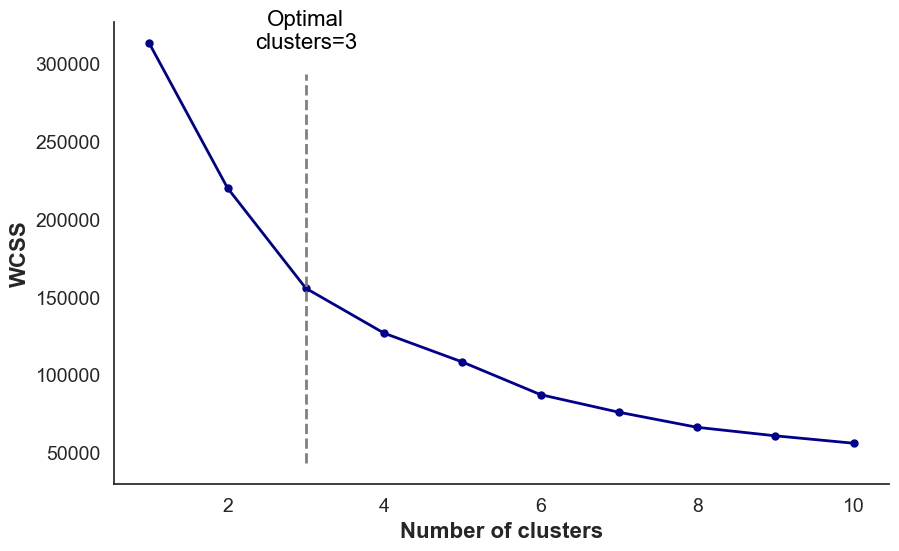

In [15]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming 'aggregated' DataFrame is defined somewhere above this code

# Scale the features
features = aggregated[['AvgKmDriven','AvgSpeed', 'Count']]
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

wcss = []
for i in range(1, 11):  # Test k from 1 to 10
    kmeans = KMeans(n_clusters=i, n_init='auto', random_state=42)
    kmeans.fit(features_scaled)
    wcss.append(kmeans.inertia_)

sns.set(style="white")  # Set the seaborn style to white background

plt.figure(figsize=(10, 6))  # Set the figure size
plt.plot(range(1, 11), wcss, color='darkblue', linewidth=2, marker='o', markersize=5)  # Plot the WCSS curve
#plt.title('Elbow Method', fontsize=16)  # Set the title
plt.xlabel('Number of clusters', fontweight = 'bold', fontsize=16)  # Set the x-axis label
plt.ylabel('WCSS', fontweight = 'bold', fontsize=16)  # Set the y-axis label
# Calculate the y limits for 85% height of the axvline
y_min, y_max = plt.ylim()
y_lim = (y_min, y_max*0.9)
# set xticks font size
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Draw a vertical line at x=3 with custom y limits
plt.vlines(x=3, ymin=y_lim[0], ymax=y_lim[1], colors='gray', linestyles='--', linewidth=2)

# Optionally, you can add annotations to mark the optimal number of clusters
plt.text(3, y_max * 0.95, 'Optimal\nclusters=3', color='black', horizontalalignment='center', fontsize=16)
sns.despine()
plt.show()


In [16]:
# see the labels for the best k
kmeans = KMeans(n_clusters=3,  n_init='auto', random_state=42, max_iter=500,)
kmeans.fit(features_scaled)
labels = kmeans.labels_

In [17]:
# add labels to the aggregated dataframe
aggregated['UserCluster'] = labels

In [18]:
# joint aggregated Cluster column to trips based on UserId
trips = trips.merge(aggregated[['UserId','UserCluster']], on='UserId', how='left')

In [19]:
# in UserCluster replace 0, 1,2 with 'Active Users', 'Moderately Active Users', 'Occasional Users'
trips['UserCluster'] = trips['UserCluster'].replace({2: 'Active Users', 1: 'Moderately Active Users', 0: 'Occasional Users'})

In [20]:
trips.UserCluster.value_counts()

UserCluster
Occasional Users           183878
Active Users               112005
Moderately Active Users     66818
Name: count, dtype: int64

In [21]:
trips.UserCategory.value_counts()

UserCategory
Occasional Users           136193
Active Users               130549
Moderately Active Users     95959
Name: count, dtype: int64

In [22]:
# 

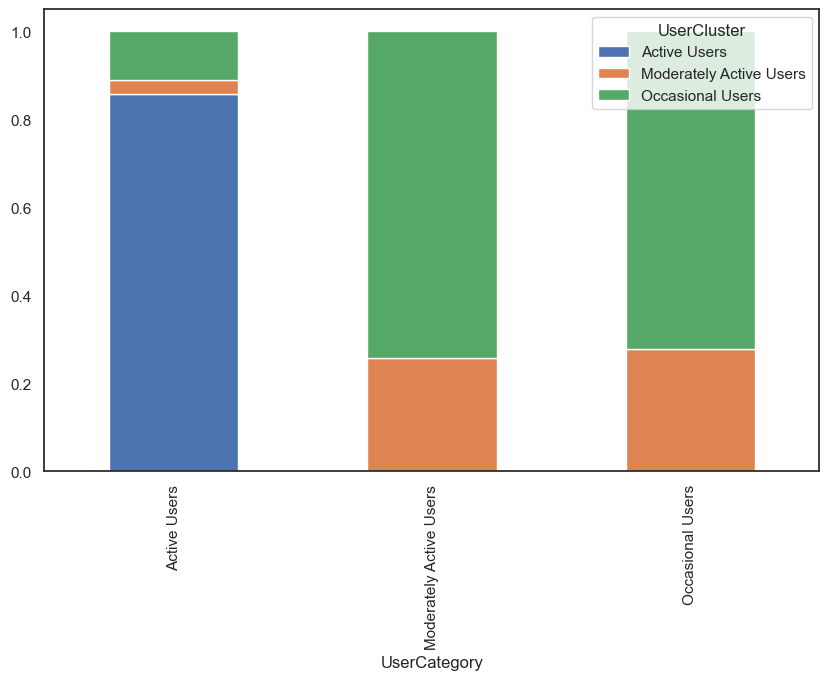

In [23]:
# groupby UserCategory and count Cluster
trips.groupby('UserCategory')['UserCluster'].value_counts(normalize=True).unstack().plot(kind='bar', stacked=True, figsize=(10, 6))
plt.show()

In [41]:
# Assuming 'trips_melted' DataFrame and 'Changes' and 'DurationType' columns are defined

# Define colors for each duration type
colors = ['#1f77b4', 'green', 'blue']

# Create subplots with 1 row and 3 columns
fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.04, subplot_titles=['Active Users', 'Moderately Active Users', 'Occasional Users' ])
# Loop through each category and create distplots
for i, category in enumerate(sorted(trips['UserCluster'].unique())):
    # Filter data for the category and duration type
    category_data = trips[trips['UserCluster'] == category]
    bike_duration_data = category_data['DistanceKm']
    # Define the desired number of bins
    desired_nbins = 30

    # Calculate the range of your data (max - min)
    start = bike_duration_data.min()
    end = bike_duration_data.max()
    data_range = end - start

    # Calculate the bin size based on the desired number of bins
    bin_size = data_range / desired_nbins
    # Create distplots for the current category
    hist_data = [bike_duration_data]
    group_labels = [category]
    distplot_fig = ff.create_distplot(hist_data, group_labels,  show_hist=True, show_rug=False, colors=colors, bin_size=bin_size)
    
    # Extract the traces from the distplot and add them to the subplots
    for j, trace in enumerate(distplot_fig['data']):
         # Show legend only for the first subplot and first two traces
        fig.add_trace(trace, row=1, col=i+1)
        #fig.data[-1].update(showlegend=show_legend)
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_bike = stats.shapiro(bike_duration_data.sample(min(5000, len(bike_duration_data))))

    fig.add_annotation(
        text=f"Distance Normality p-value: {shapiro_bike.pvalue:.3f}",
        xref=f"x{i+1}", yref="paper",
        x=end,
        y=0.93,
        showarrow=False,
        font=dict(size=14, color='#1f77b4'),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )

# Update layout
fig.update_layout(
    
    margin=dict(l=20, r=20, t=100, b=20),
   #title= dict(font = dict(size=22), text='Distance KDE by User Category', x = 0.5, xanchor = 'center', y = 0.98),
    height=650, width=1200,
    legend=dict(orientation="h", yanchor="top", y=1.17, x=0.5, traceorder='normal', xanchor='center',font=dict(size=16)),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
)
fig.update_xaxes(title_text='Distance', row=1, col=2, title_font=dict(size=18), tickfont=dict(size=16))
fig.update_xaxes(row=1, col=1,  tickfont=dict(size=16))
fig.update_xaxes(row=1, col=3,  tickfont=dict(size=16))
fig.update_yaxes(title_text='Density', row=1, col=1, title_font=dict(size=18), tickfont=dict(size=16))
fig.update_yaxes(row=1, col=2,  tickfont=dict(size=16))
fig.update_yaxes(row=1, col=3,  tickfont=dict(size=16))
# Show the figure
fig.show()


In [25]:
trips.DistanceKm = trips.DistanceKm.astype('float32')

In [26]:
trips.UserCluster = trips.UserCluster.astype('category')

In [27]:
# perform anova for difference between groups for HaversineDistance
pairwise_results_d = pg.pairwise_tests(data=trips, dv='DistanceKm', between='UserCluster', padjust='bonf', alpha = 0.05, parametric=True, effsize="hedges").round(4)
pairwise_results_d

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide



,Contrast,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,UserCluster,Active Users,Moderately Active Users,False,True,-157.7745,113078.0887,two-sided,0.0,0.0,bonf,inf,-0.8247
1,UserCluster,Active Users,Occasional Users,False,True,97.1727,168276.2729,two-sided,0.0,0.0,bonf,inf,0.4081
2,UserCluster,Moderately Active Users,Occasional Users,False,True,237.0310,78620.1559,two-sided,0.0,0.0,bonf,inf,1.4399


In [28]:
trips= trips[trips['SpeedKmHr']<100]

In [47]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
from scipy import stats

# Assuming 'trips' DataFrame is defined with 'UserCategory' and 'SpeedKmHrHav' columns

# Define colors for the plot
colors = ['purple', 'orange', '#1f77b4']  # Different colors for each UserCategory
max_speed = trips['SpeedKmHr'].max() 
# Create an empty figure
fig = go.Figure()

# Loop through each category to add KDE plot
for i, (category, color) in enumerate(zip(sorted(trips['UserCluster'].unique()), colors)):
    category_data = trips[trips['UserCluster'] == category]['SpeedKmHr']
    
    # Calculate the KDE
    kde = stats.gaussian_kde(category_data)
    x_range = np.linspace(category_data.min(), category_data.max(), 1000)
    kde_values = kde.evaluate(x_range)
    
    # Add trace for the KDE
    fig.add_trace(go.Scatter(x=x_range, y=kde_values, fill='tozeroy', name=category,
                             line=dict(color=color), opacity=0.0))
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_test = stats.shapiro(category_data.sample(min(5000, len(category_data))))
    p_value = shapiro_test.pvalue
    
    # Add annotation for Shapiro-Wilk test p-value
    fig.add_annotation(x=0.95, y=0.95-(i*0.05), text=f'{category} Norm p-value: {p_value:.3f}',
                       showarrow=False, xref="paper", yref="paper",
                       font=dict(size=14, color=color), bgcolor="rgba(255, 255, 255, 0.9)",
                       xanchor='right')

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    #title=dict(font = dict(size=22),text='Speed KDE by User Category', x=0.5, xanchor='center', y = 0.98),
    xaxis_title_text='Speed (km/hr)',
    yaxis_title_text='Density',
    xaxis_range=[2, max_speed],
    xaxis_showgrid=False,
    height=600, width=900,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="center", x=0.5, font = dict(size=16)),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
    xaxis_tickfont=dict(size=14),
    yaxis_tickfont=dict(size=14)
)
fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))
fig.show()

In [30]:
# group by UserCluster and calculate speed average
trips.groupby("UserCluster")['SpeedKmHr'].mean()

C:\Users\mihai\AppData\Local\Temp\ipykernel_6860\3905587415.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



UserCluster
Active Users               17.729102
Moderately Active Users    25.126823
Occasional Users           14.401524
Name: SpeedKmHr, dtype: float64

In [31]:
trips.UserCluster.value_counts()

UserCluster
Occasional Users           183878
Active Users               112005
Moderately Active Users     66817
Name: count, dtype: int64

In [32]:
# perform anova for difference between groups for HaversineDistance
pairwise_results_sp = pg.pairwise_tests(data=trips, dv='SpeedKmHr', between='UserCluster', padjust='bonf', alpha = 0.05, parametric=True, effsize="hedges").round(4)
pairwise_results_sp

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\bayesian.py:152: RuntimeWarning:

divide by zero encountered in scalar divide



,Contrast,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,UserCluster,Active Users,Moderately Active Users,False,True,-155.9738,121520.5073,two-sided,0.0,0.0,bonf,inf,-0.7974
1,UserCluster,Active Users,Occasional Users,False,True,115.6858,168661.0008,two-sided,0.0,0.0,bonf,inf,0.4855
2,UserCluster,Moderately Active Users,Occasional Users,False,True,256.1301,81163.2758,two-sided,0.0,0.0,bonf,inf,1.5075
